In [71]:
# 과제 1 

In [2]:
import numpy as np
import pandas as pd
import random
from collections import defaultdict
import gym
import gym_minigrid
import matplotlib.pyplot as plt
%matplotlib inline

In [17]:
class QLearning:
    def __init__(self, actions, agent_indicator=10):
        self.actions = actions
        self.agent_indicator = agent_indicator
        self.alpha = 0.01
        self.gamma = 0.9
        self.epsilon = 0.2
        self.q_values = defaultdict(lambda: [0.0] * actions)
        
    def _convert_state(self, s):
        return tuple(s.tolist())
        
    def update(self, state, action, reward, next_state, next_action):
        state = self._convert_state(state)
        next_state = self._convert_state(next_state)
        
        q_value = self.q_values[state][action]
        
        next_q_value = max(self.q_values[next_state])  # Q-Learning은 max 사용
        
        td_error = reward + self.gamma * next_q_value - q_value
        self.q_values[state][action] += self.alpha * td_error

    def act(self, state):
        if np.random.rand() < self.epsilon:
            action = np.random.choice(self.actions)
        else:
            state = self._convert_state(state)
            q_values = self.q_values[state]
            action = np.argmax(q_values)
        return action

In [6]:
from utils import gen_wrapped_env, show_video

In [75]:
env = gen_wrapped_env('MiniGrid-Empty-6x6-v0')
# env = gen_wrapped_env('MiniGrid-DoorKey-5x5-v0')

obs = env.reset()

agent_position = obs[0]

agent = QLearning(4, agent_position)

In [76]:
# q-learning 
rewards = []
for ep in range(100000):
    done = False
    obs = env.reset()
    action = agent.act(obs)
    
    ep_rewards = 0
    while not done:
        next_obs, reward, done, info = env.step(action)

        next_action = agent.act(next_obs)

        agent.update(obs, action, reward, next_obs, next_action)
        
        ep_rewards += reward
        obs = next_obs
        action = next_action
    rewards.append(ep_rewards)
    if (ep+1) % 20 == 0:
        print("episode: {}, rewards: {}".format(ep+1, ep_rewards))
env.close()

episode: 20, rewards: 0
episode: 40, rewards: 0
episode: 60, rewards: 0
episode: 80, rewards: 0
episode: 100, rewards: 0
episode: 120, rewards: 0
episode: 140, rewards: 0
episode: 160, rewards: 0
episode: 180, rewards: 0
episode: 200, rewards: 0
episode: 220, rewards: 0
episode: 240, rewards: 0
episode: 260, rewards: 0
episode: 280, rewards: 0
episode: 300, rewards: 0
episode: 320, rewards: 0
episode: 340, rewards: 0
episode: 360, rewards: 0
episode: 380, rewards: 0
episode: 400, rewards: 0
episode: 420, rewards: 0
episode: 440, rewards: 0
episode: 460, rewards: 0
episode: 480, rewards: 0
episode: 500, rewards: 0
episode: 520, rewards: 0
episode: 540, rewards: 0
episode: 560, rewards: 0
episode: 580, rewards: 0
episode: 600, rewards: 0
episode: 620, rewards: 0
episode: 640, rewards: 0
episode: 660, rewards: 0
episode: 680, rewards: 0
episode: 700, rewards: 0
episode: 720, rewards: 0
episode: 740, rewards: 0
episode: 760, rewards: 0
episode: 780, rewards: 0
episode: 800, rewards: 0
epis

In [77]:
print(len(agent.q_values)) 
print(rewards[-10:])

62
[0.874, 0.802, 0.838, 0.856, 0.874, 0.856, 0.874, 0.802, 0.838, 0.874]


In [60]:
{s:np.round(q, 5).tolist() for s, q in agent.q_values.items()}

{(10,
  0,
  0,
  1,
  0,
  0,
  1,
  0,
  0,
  1,
  0,
  0,
  1,
  0,
  0,
  1,
  0,
  0,
  1,
  0,
  0,
  1,
  0,
  0,
  1,
  0,
  0,
  1,
  0,
  0,
  1,
  0,
  0,
  1,
  0,
  0,
  1,
  0,
  0,
  1,
  0,
  0,
  1,
  0,
  0,
  8,
  1,
  0): [0.35925, 0.35923, 0.4419, 0.39889],
 (10,
  0,
  3,
  1,
  0,
  0,
  1,
  0,
  0,
  1,
  0,
  0,
  1,
  0,
  0,
  1,
  0,
  0,
  1,
  0,
  0,
  1,
  0,
  0,
  1,
  0,
  0,
  1,
  0,
  0,
  1,
  0,
  0,
  1,
  0,
  0,
  1,
  0,
  0,
  1,
  0,
  0,
  1,
  0,
  0,
  8,
  1,
  0): [0.29837, 0.39879, 0.34944, 0.34741],
 (10,
  0,
  2,
  1,
  0,
  0,
  1,
  0,
  0,
  1,
  0,
  0,
  1,
  0,
  0,
  1,
  0,
  0,
  1,
  0,
  0,
  1,
  0,
  0,
  1,
  0,
  0,
  1,
  0,
  0,
  1,
  0,
  0,
  1,
  0,
  0,
  1,
  0,
  0,
  1,
  0,
  0,
  1,
  0,
  0,
  8,
  1,
  0): [0.35849, 0.10899, 0.1015, 0.10126],
 (10,
  0,
  1,
  1,
  0,
  0,
  1,
  0,
  0,
  1,
  0,
  0,
  1,
  0,
  0,
  1,
  0,
  0,
  1,
  0,
  0,
  1,
  0,
  0,
  1,
  0,
  0,
  1,
  0,
  0,
  1,
  0,
 

In [61]:
show_video()

In [65]:
# import os
# os.makedirs('./logs', exist_ok=True)

# import pandas as pd
# print(pd.__version__)

# pd.Series(rewards).to_csv('./logs/rewards_qlearning.csv')
import os
import numpy as np

# 디렉토리 만들기
os.makedirs('./logs', exist_ok=True)

# numpy로 CSV 저장
np.savetxt('./logs/rewards_qlearning.csv', rewards, delimiter=',')


In [ ]:
# sarsa_logs = pd.read_csv('./logs/rewards_sarsa.csv', index_col=False).iloc[:, 1]
q_logs = pd.read_csv('./logs/rewards_qlearning.csv', index_col=False).iloc[:, 1]

In [67]:
import numpy as np

q_logs = np.loadtxt('./logs/rewards_qlearning.csv', delimiter=',')
print(q_logs[:10])  # 앞 부분 확인

[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


In [ ]:
plt.figure(figsize=(16, 8))
plt.plot(q_logs.cumsum() / (pd.Series(np.arange(q_logs.shape[0]))+1), label="QLearning")
plt.legend()

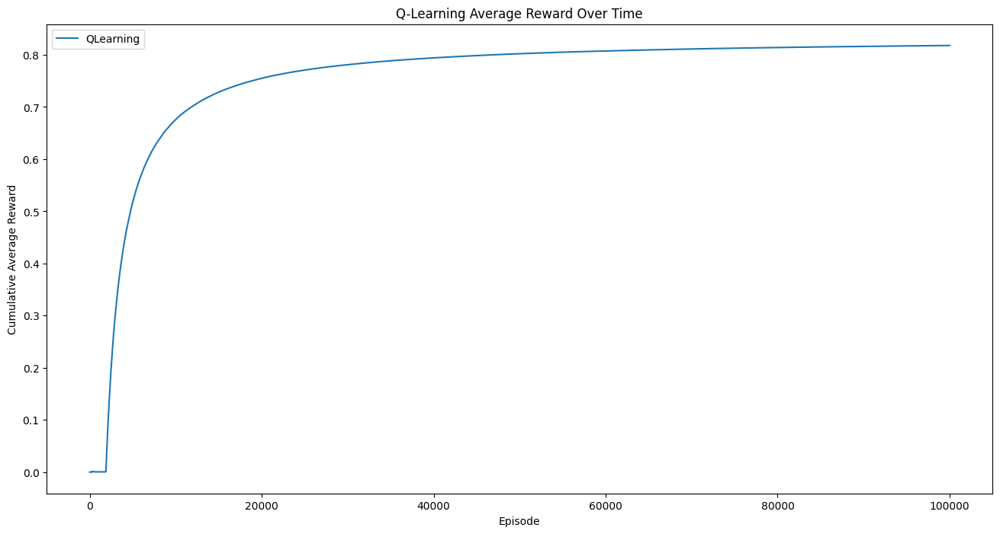

In [68]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# numpy 배열을 pandas Series로 변환
q_logs_series = pd.Series(q_logs)

plt.figure(figsize=(16, 8))
plt.plot(q_logs_series.cumsum() / (pd.Series(np.arange(q_logs_series.shape[0]))+1), label="QLearning")
plt.xlabel('Episode')
plt.ylabel('Cumulative Average Reward')
plt.title('Q-Learning Average Reward Over Time')
plt.legend()
plt.show()


In [7]:
class SARSA:
    def __init__(self, actions, agent_indicator=10):
        self.actions = actions
        self.agent_indicator = agent_indicator
        self.alpha = 0.01
        self.gamma = 0.9
        self.epsilon = 0.2
        self.q_values = defaultdict(lambda: [0.0] * actions)
        
    def _convert_state(self, s):
        return np.where(s == self.agent_indicator)[0][0]
    
    def update(self, state, action, reward, next_state, next_action):
        state = self._convert_state(state)
        next_state = self._convert_state(next_state)
        
        q_value = self.q_values[state][action]
        next_q_value = self.q_values[next_state][next_action]
        td_error = reward + self.gamma * next_q_value - q_value
        self.q_values[state][action] += self.alpha * td_error
    
    def act(self, state):
        if np.random.rand() < self.epsilon:
            action = np.random.choice(self.actions)
        else:
            state = self._convert_state(state)
            q_values = self.q_values[state]
            action = np.argmax(q_values)
        return action


env = gen_wrapped_env('MiniGrid-Empty-6x6-v0')
# env = gen_wrapped_env('MiniGrid-DoorKey-5x5-v0')

obs = env.reset()

agent_position = obs[0]

agent = SARSA(4, agent_position)

In [8]:
# sarsa 
rewards = []
for ep in range(100000):
    done = False
    obs = env.reset()
    action = agent.act(obs)
    
    ep_rewards = 0
    while not done:
        next_obs, reward, done, info = env.step(action)

        next_action = agent.act(next_obs)

        agent.update(obs, action, reward, next_obs, next_action)
        
        ep_rewards += reward
        obs = next_obs
        action = next_action
    rewards.append(ep_rewards)
    if (ep+1) % 20 == 0:
        print("episode: {}, rewards: {}".format(ep+1, ep_rewards))
env.close()

episode: 20, rewards: 0
episode: 40, rewards: 0
episode: 60, rewards: 0
episode: 80, rewards: 0
episode: 100, rewards: 0
episode: 120, rewards: 0
episode: 140, rewards: 0
episode: 160, rewards: 0
episode: 180, rewards: 0
episode: 200, rewards: 0
episode: 220, rewards: 0
episode: 240, rewards: 0
episode: 260, rewards: 0
episode: 280, rewards: 0
episode: 300, rewards: 0
episode: 320, rewards: 0
episode: 340, rewards: 0
episode: 360, rewards: 0
episode: 380, rewards: 0
episode: 400, rewards: 0
episode: 420, rewards: 0
episode: 440, rewards: 0
episode: 460, rewards: 0
episode: 480, rewards: 0
episode: 500, rewards: 0
episode: 520, rewards: 0
episode: 540, rewards: 0
episode: 560, rewards: 0
episode: 580, rewards: 0
episode: 600, rewards: 0
episode: 620, rewards: 0
episode: 640, rewards: 0
episode: 660, rewards: 0
episode: 680, rewards: 0
episode: 700, rewards: 0
episode: 720, rewards: 0
episode: 740, rewards: 0
episode: 760, rewards: 0
episode: 780, rewards: 0
episode: 800, rewards: 0
epis

In [9]:
print(len(agent.q_values)) 
print(rewards[-10:])

16
[0.3879999999999999, 0.838, 0.6579999999999999, 0.622, 0, 0.6759999999999999, 0.82, 0.44199999999999995, 0.5680000000000001, 0]


In [10]:
{s:np.round(q, 5).tolist() for s, q in agent.q_values.items()}

{0: [0.02288, 0.02314, 0.02827, 0.02303],
 12: [0.04456, 0.04455, 0.05241, 0.04413],
 24: [0.06112, 0.06103, 0.07023, 0.06057],
 3: [0.01895, 0.01883, 0.02041, 0.01896],
 15: [0.06996, 0.07044, 0.08178, 0.07022],
 27: [0.16827, 0.16926, 0.19299, 0.16958],
 18: [0.09093, 0.09036, 0.10629, 0.09103],
 30: [0.21697, 0.21956, 0.24573, 0.21569],
 42: [0.47544, 0.47602, 0.51702, 0.47594],
 39: [0.35663, 0.35488, 0.38485, 0.35494],
 36: [0.07378, 0.07366, 0.08388, 0.07399],
 6: [0.01982, 0.01996, 0.02245, 0.01998],
 9: [0.02248, 0.02255, 0.02844, 0.02214],
 21: [0.10947, 0.11007, 0.13806, 0.10978],
 33: [0.26195, 0.25793, 0.33065, 0.26139],
 45: [0.0, 0.0, 0.0, 0.0]}

In [11]:
show_video()

In [12]:
# sarsa 
rewards = []
for ep in range(500000):
    done = False
    obs = env.reset()
    action = agent.act(obs)
    
    ep_rewards = 0
    while not done:
        next_obs, reward, done, info = env.step(action)

        next_action = agent.act(next_obs)

        agent.update(obs, action, reward, next_obs, next_action)
        
        ep_rewards += reward
        obs = next_obs
        action = next_action
    rewards.append(ep_rewards)
    if (ep+1) % 20 == 0:
        print("episode: {}, rewards: {}".format(ep+1, ep_rewards))
env.close()

episode: 20, rewards: 0.748
episode: 40, rewards: 0
episode: 60, rewards: 0.712
episode: 80, rewards: 0.856
episode: 100, rewards: 0
episode: 120, rewards: 0
episode: 140, rewards: 0.856
episode: 160, rewards: 0.22599999999999998
episode: 180, rewards: 0
episode: 200, rewards: 0.856
episode: 220, rewards: 0.532
episode: 240, rewards: 0.73
episode: 260, rewards: 0.18999999999999995
episode: 280, rewards: 0
episode: 300, rewards: 0
episode: 320, rewards: 0.586
episode: 340, rewards: 0.6399999999999999
episode: 360, rewards: 0
episode: 380, rewards: 0.33399999999999996
episode: 400, rewards: 0.82
episode: 420, rewards: 0
episode: 440, rewards: 0.352
episode: 460, rewards: 0.4059999999999999
episode: 480, rewards: 0
episode: 500, rewards: 0
episode: 520, rewards: 0
episode: 540, rewards: 0.766
episode: 560, rewards: 0
episode: 580, rewards: 0.5680000000000001
episode: 600, rewards: 0
episode: 620, rewards: 0.73
episode: 640, rewards: 0.09999999999999998
episode: 660, rewards: 0
episode: 68

In [14]:
print(len(agent.q_values)) 
print(rewards[-10:])
{s:np.round(q, 5).tolist() for s, q in agent.q_values.items()}
show_video()

16
[0.604, 0, 0, 0.45999999999999996, 0, 0, 0, 0.73, 0.73, 0.6759999999999999]


In [23]:
# sarsa 
rewards = []
for ep in range(5000000):
    done = False
    obs = env.reset()
    action = agent.act(obs)
    
    ep_rewards = 0
    while not done:
        next_obs, reward, done, info = env.step(action)

        next_action = agent.act(next_obs)

        agent.update(obs, action, reward, next_obs, next_action)
        
        ep_rewards += reward
        obs = next_obs
        action = next_action
    rewards.append(ep_rewards)
    if (ep+1) % 20 == 0:
        print("episode: {}, rewards: {}".format(ep+1, ep_rewards))
env.close()

episode: 20, rewards: 0
episode: 40, rewards: 0.838
episode: 60, rewards: 0
episode: 80, rewards: 0
episode: 100, rewards: 0
episode: 120, rewards: 0.18999999999999995
episode: 140, rewards: 0
episode: 160, rewards: 0
episode: 180, rewards: 0
episode: 200, rewards: 0
episode: 220, rewards: 0
episode: 240, rewards: 0
episode: 260, rewards: 0
episode: 280, rewards: 0
episode: 300, rewards: 0
episode: 320, rewards: 0
episode: 340, rewards: 0
episode: 360, rewards: 0
episode: 380, rewards: 0
episode: 400, rewards: 0
episode: 420, rewards: 0
episode: 440, rewards: 0
episode: 460, rewards: 0
episode: 480, rewards: 0
episode: 500, rewards: 0
episode: 520, rewards: 0
episode: 540, rewards: 0
episode: 560, rewards: 0
episode: 580, rewards: 0
episode: 600, rewards: 0
episode: 620, rewards: 0
episode: 640, rewards: 0
episode: 660, rewards: 0.20799999999999996
episode: 680, rewards: 0
episode: 700, rewards: 0
episode: 720, rewards: 0
episode: 740, rewards: 0
episode: 760, rewards: 0
episode: 780, 

In [24]:
print(len(agent.q_values)) 
print(rewards[-10:])
{s:np.round(q, 5).tolist() for s, q in agent.q_values.items()}
show_video()

16
[0.604, 0.2799999999999999, 0.6579999999999999, 0.6759999999999999, 0, 0.802, 0.6759999999999999, 0, 0.802, 0]


In [26]:
# sarsa 
rewards = []
for ep in range(10000000):
    done = False
    obs = env.reset()
    action = agent.act(obs)
    
    ep_rewards = 0
    while not done:
        next_obs, reward, done, info = env.step(action)

        next_action = agent.act(next_obs)

        agent.update(obs, action, reward, next_obs, next_action)
        
        ep_rewards += reward
        obs = next_obs
        action = next_action
    rewards.append(ep_rewards)
    if (ep+1) % 20 == 0:
        print("episode: {}, rewards: {}".format(ep+1, ep_rewards))
env.close()

episode: 20, rewards: 0
episode: 40, rewards: 0
episode: 60, rewards: 0.4059999999999999
episode: 80, rewards: 0
episode: 100, rewards: 0
episode: 120, rewards: 0.15400000000000003
episode: 140, rewards: 0.244
episode: 160, rewards: 0
episode: 180, rewards: 0.856
episode: 200, rewards: 0
episode: 220, rewards: 0
episode: 240, rewards: 0
episode: 260, rewards: 0
episode: 280, rewards: 0
episode: 300, rewards: 0.622
episode: 320, rewards: 0
episode: 340, rewards: 0
episode: 360, rewards: 0
episode: 380, rewards: 0
episode: 400, rewards: 0
episode: 420, rewards: 0
episode: 440, rewards: 0
episode: 460, rewards: 0
episode: 480, rewards: 0
episode: 500, rewards: 0
episode: 520, rewards: 0
episode: 540, rewards: 0.18999999999999995
episode: 560, rewards: 0.3879999999999999
episode: 580, rewards: 0
episode: 600, rewards: 0
episode: 620, rewards: 0
episode: 640, rewards: 0
episode: 660, rewards: 0.856
episode: 680, rewards: 0
episode: 700, rewards: 0
episode: 720, rewards: 0.42399999999999993


In [27]:
print(len(agent.q_values)) 
print(rewards[-10:])
{s:np.round(q, 5).tolist() for s, q in agent.q_values.items()}
show_video()

16
[0.514, 0, 0, 0, 0, 0, 0, 0, 0, 0]


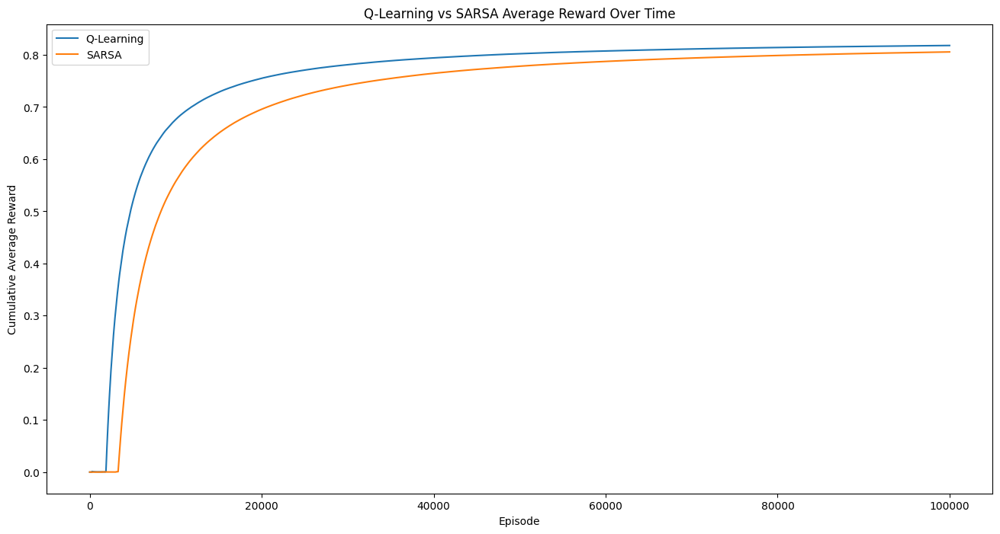

In [15]:
import pandas as pd
import matplotlib.pyplot as plt

# SARSA 로그 불러오기
sarsa_logs = pd.read_csv('./logs/rewards_sarsa.csv', header=None).iloc[:, 0]

# Q-Learning 로그도 불러오기 (비교용, 이미 저장돼 있다고 가정)
q_logs = np.loadtxt('./logs/rewards_qlearning.csv', delimiter=',')

# Q-Learning 시각화
q_logs_series = pd.Series(q_logs)
plt.figure(figsize=(16, 8))
plt.plot(q_logs_series.cumsum() / (np.arange(q_logs_series.shape[0]) + 1), label="Q-Learning")

# SARSA 시각화
sarsa_logs_series = pd.Series(sarsa_logs)
plt.plot(sarsa_logs_series.cumsum() / (np.arange(sarsa_logs_series.shape[0]) + 1), label="SARSA")

plt.xlabel('Episode')
plt.ylabel('Cumulative Average Reward')
plt.title('Q-Learning vs SARSA Average Reward Over Time')
plt.legend()
plt.show()

In [ ]:
# 과제 3 


==== γ = 0.1 실험 시작 ====

γ=0.1, Episode: 100, Avg Reward (last 100): 0.0
γ=0.1, Episode: 200, Avg Reward (last 100): 0.0
γ=0.1, Episode: 300, Avg Reward (last 100): 0.0
γ=0.1, Episode: 400, Avg Reward (last 100): 0.0
γ=0.1, Episode: 500, Avg Reward (last 100): 0.0
γ=0.1, Episode: 600, Avg Reward (last 100): 0.0
γ=0.1, Episode: 700, Avg Reward (last 100): 0.0
γ=0.1, Episode: 800, Avg Reward (last 100): 0.0
γ=0.1, Episode: 900, Avg Reward (last 100): 0.0
γ=0.1, Episode: 1000, Avg Reward (last 100): 0.0
γ=0.1, Episode: 1100, Avg Reward (last 100): 0.0
γ=0.1, Episode: 1200, Avg Reward (last 100): 0.0
γ=0.1, Episode: 1300, Avg Reward (last 100): 0.0
γ=0.1, Episode: 1400, Avg Reward (last 100): 0.0011799999999999998
γ=0.1, Episode: 1500, Avg Reward (last 100): 0.0
γ=0.1, Episode: 1600, Avg Reward (last 100): 0.0
γ=0.1, Episode: 1700, Avg Reward (last 100): 0.0
γ=0.1, Episode: 1800, Avg Reward (last 100): 0.0
γ=0.1, Episode: 1900, Avg Reward (last 100): 0.0
γ=0.1, Episode: 2000, Avg Reward (

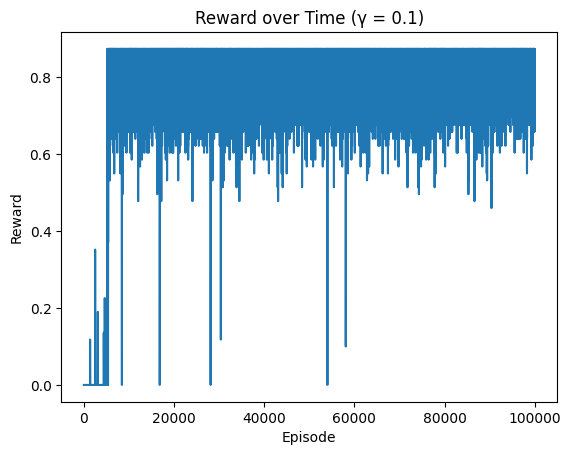


==== γ = 0.5 실험 시작 ====

γ=0.5, Episode: 100, Avg Reward (last 100): 0.0
γ=0.5, Episode: 200, Avg Reward (last 100): 0.0
γ=0.5, Episode: 300, Avg Reward (last 100): 0.0
γ=0.5, Episode: 400, Avg Reward (last 100): 0.0
γ=0.5, Episode: 500, Avg Reward (last 100): 0.0
γ=0.5, Episode: 600, Avg Reward (last 100): 0.0
γ=0.5, Episode: 700, Avg Reward (last 100): 0.0
γ=0.5, Episode: 800, Avg Reward (last 100): 0.0
γ=0.5, Episode: 900, Avg Reward (last 100): 0.0
γ=0.5, Episode: 1000, Avg Reward (last 100): 0.0
γ=0.5, Episode: 1100, Avg Reward (last 100): 0.0
γ=0.5, Episode: 1200, Avg Reward (last 100): 0.0
γ=0.5, Episode: 1300, Avg Reward (last 100): 0.0
γ=0.5, Episode: 1400, Avg Reward (last 100): 0.0
γ=0.5, Episode: 1500, Avg Reward (last 100): 0.0
γ=0.5, Episode: 1600, Avg Reward (last 100): 0.0
γ=0.5, Episode: 1700, Avg Reward (last 100): 0.0
γ=0.5, Episode: 1800, Avg Reward (last 100): 0.0
γ=0.5, Episode: 1900, Avg Reward (last 100): 0.0
γ=0.5, Episode: 2000, Avg Reward (last 100): 0.0
γ=0

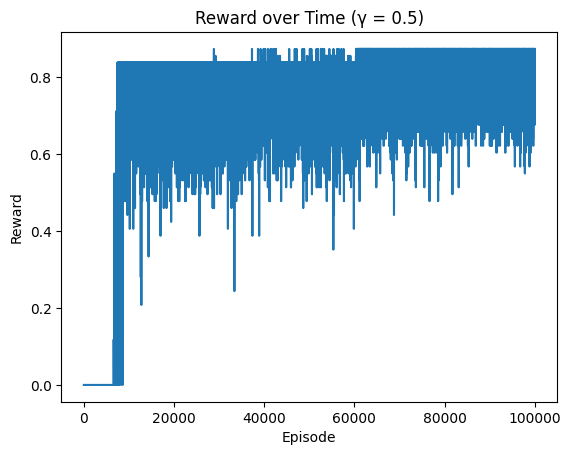


==== γ = 0.9 실험 시작 ====

γ=0.9, Episode: 100, Avg Reward (last 100): 0.0
γ=0.9, Episode: 200, Avg Reward (last 100): 0.0
γ=0.9, Episode: 300, Avg Reward (last 100): 0.0
γ=0.9, Episode: 400, Avg Reward (last 100): 0.0
γ=0.9, Episode: 500, Avg Reward (last 100): 0.0
γ=0.9, Episode: 600, Avg Reward (last 100): 0.0
γ=0.9, Episode: 700, Avg Reward (last 100): 0.0
γ=0.9, Episode: 800, Avg Reward (last 100): 0.0
γ=0.9, Episode: 900, Avg Reward (last 100): 0.0
γ=0.9, Episode: 1000, Avg Reward (last 100): 0.0
γ=0.9, Episode: 1100, Avg Reward (last 100): 0.0
γ=0.9, Episode: 1200, Avg Reward (last 100): 0.0
γ=0.9, Episode: 1300, Avg Reward (last 100): 0.0
γ=0.9, Episode: 1400, Avg Reward (last 100): 0.0
γ=0.9, Episode: 1500, Avg Reward (last 100): 0.0
γ=0.9, Episode: 1600, Avg Reward (last 100): 0.0
γ=0.9, Episode: 1700, Avg Reward (last 100): 0.0
γ=0.9, Episode: 1800, Avg Reward (last 100): 0.0
γ=0.9, Episode: 1900, Avg Reward (last 100): 0.0
γ=0.9, Episode: 2000, Avg Reward (last 100): 0.0
γ=0

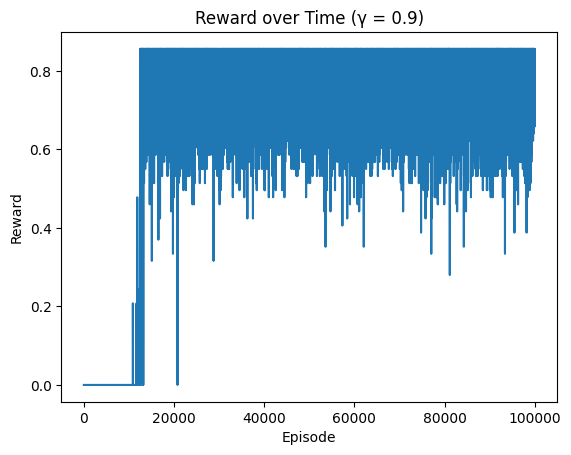


==== γ = 0.99 실험 시작 ====

γ=0.99, Episode: 100, Avg Reward (last 100): 0.0
γ=0.99, Episode: 200, Avg Reward (last 100): 0.0
γ=0.99, Episode: 300, Avg Reward (last 100): 0.0
γ=0.99, Episode: 400, Avg Reward (last 100): 0.0
γ=0.99, Episode: 500, Avg Reward (last 100): 0.0
γ=0.99, Episode: 600, Avg Reward (last 100): 0.0
γ=0.99, Episode: 700, Avg Reward (last 100): 0.0
γ=0.99, Episode: 800, Avg Reward (last 100): 0.0
γ=0.99, Episode: 900, Avg Reward (last 100): 0.0
γ=0.99, Episode: 1000, Avg Reward (last 100): 0.0
γ=0.99, Episode: 1100, Avg Reward (last 100): 0.0
γ=0.99, Episode: 1200, Avg Reward (last 100): 0.0
γ=0.99, Episode: 1300, Avg Reward (last 100): 0.00136
γ=0.99, Episode: 1400, Avg Reward (last 100): 0.0
γ=0.99, Episode: 1500, Avg Reward (last 100): 0.0
γ=0.99, Episode: 1600, Avg Reward (last 100): 0.0
γ=0.99, Episode: 1700, Avg Reward (last 100): 0.0
γ=0.99, Episode: 1800, Avg Reward (last 100): 0.0
γ=0.99, Episode: 1900, Avg Reward (last 100): 0.0
γ=0.99, Episode: 2000, Avg R

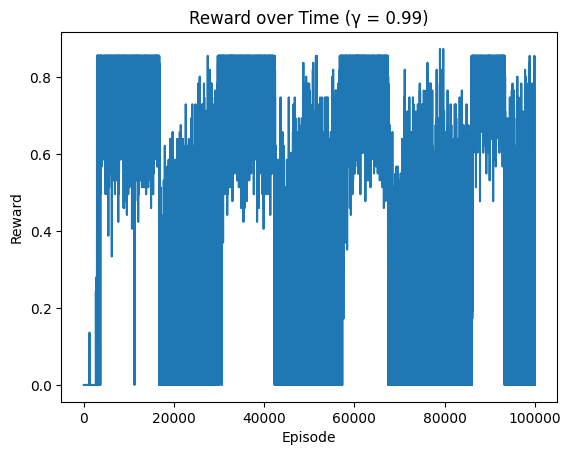

In [18]:
# q- learning

gamma_values = [0.1, 0.5, 0.9, 0.99]
num_episodes = 100000

for gamma in gamma_values:
    print(f"\n==== γ = {gamma} 실험 시작 ====\n")
    
    env = gen_wrapped_env('MiniGrid-Empty-6x6-v0')  
    obs = env.reset()
    agent_position = obs[0]
    
    agent = QLearning(4, agent_position)
    agent.gamma = gamma  
    
    rewards = []
    for ep in range(num_episodes):
        done = False
        obs = env.reset()
        action = agent.act(obs)
        
        ep_rewards = 0
        while not done:
            next_obs, reward, done, info = env.step(action)
            next_action = agent.act(next_obs)
            
            agent.update(obs, action, reward, next_obs, next_action)
            
            ep_rewards += reward
            obs = next_obs
            action = next_action
        
        rewards.append(ep_rewards)
        if (ep+1) % 100 == 0:
            avg_reward = np.mean(rewards[-100:])
            print(f"γ={gamma}, Episode: {ep+1}, Avg Reward (last 100): {avg_reward}")
    
    env.close()
    
    # 보상 그래프 시각화
    plt.plot(rewards)
    plt.xlabel('Episode')
    plt.ylabel('Reward')
    plt.title(f'Reward over Time (γ = {gamma})')
    plt.show()


==== SARSA γ = 0.1 실험 시작 ====

γ=0.1, Episode: 100, Avg Reward (last 100): 0.0
γ=0.1, Episode: 200, Avg Reward (last 100): 0.0
γ=0.1, Episode: 300, Avg Reward (last 100): 0.0
γ=0.1, Episode: 400, Avg Reward (last 100): 0.0
γ=0.1, Episode: 500, Avg Reward (last 100): 0.0
γ=0.1, Episode: 600, Avg Reward (last 100): 0.0
γ=0.1, Episode: 700, Avg Reward (last 100): 0.0
γ=0.1, Episode: 800, Avg Reward (last 100): 0.0
γ=0.1, Episode: 900, Avg Reward (last 100): 0.0
γ=0.1, Episode: 1000, Avg Reward (last 100): 0.0
γ=0.1, Episode: 1100, Avg Reward (last 100): 0.0
γ=0.1, Episode: 1200, Avg Reward (last 100): 0.0
γ=0.1, Episode: 1300, Avg Reward (last 100): 0.0
γ=0.1, Episode: 1400, Avg Reward (last 100): 0.0
γ=0.1, Episode: 1500, Avg Reward (last 100): 0.0
γ=0.1, Episode: 1600, Avg Reward (last 100): 0.0
γ=0.1, Episode: 1700, Avg Reward (last 100): 0.0
γ=0.1, Episode: 1800, Avg Reward (last 100): 0.0
γ=0.1, Episode: 1900, Avg Reward (last 100): 0.0
γ=0.1, Episode: 2000, Avg Reward (last 100): 0

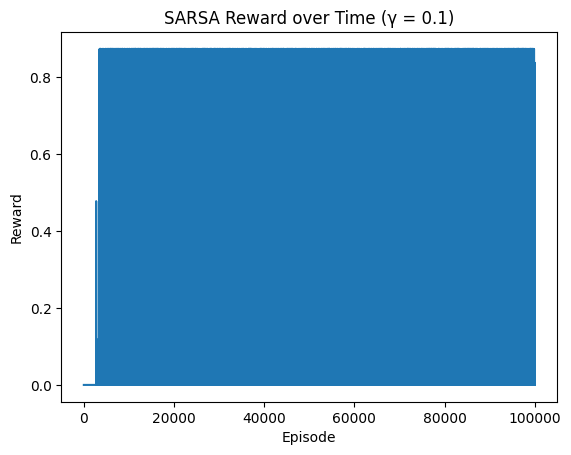


==== SARSA γ = 0.5 실험 시작 ====

γ=0.5, Episode: 100, Avg Reward (last 100): 0.0
γ=0.5, Episode: 200, Avg Reward (last 100): 0.0
γ=0.5, Episode: 300, Avg Reward (last 100): 0.0
γ=0.5, Episode: 400, Avg Reward (last 100): 0.0
γ=0.5, Episode: 500, Avg Reward (last 100): 0.0
γ=0.5, Episode: 600, Avg Reward (last 100): 0.0
γ=0.5, Episode: 700, Avg Reward (last 100): 0.0
γ=0.5, Episode: 800, Avg Reward (last 100): 0.0
γ=0.5, Episode: 900, Avg Reward (last 100): 0.0
γ=0.5, Episode: 1000, Avg Reward (last 100): 0.0
γ=0.5, Episode: 1100, Avg Reward (last 100): 0.0
γ=0.5, Episode: 1200, Avg Reward (last 100): 0.0
γ=0.5, Episode: 1300, Avg Reward (last 100): 0.0
γ=0.5, Episode: 1400, Avg Reward (last 100): 0.0
γ=0.5, Episode: 1500, Avg Reward (last 100): 0.0
γ=0.5, Episode: 1600, Avg Reward (last 100): 0.0
γ=0.5, Episode: 1700, Avg Reward (last 100): 0.0
γ=0.5, Episode: 1800, Avg Reward (last 100): 0.0
γ=0.5, Episode: 1900, Avg Reward (last 100): 0.0
γ=0.5, Episode: 2000, Avg Reward (last 100): 0

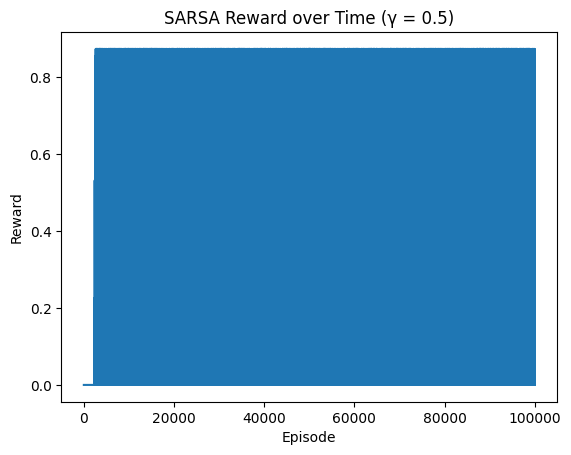


==== SARSA γ = 0.9 실험 시작 ====

γ=0.9, Episode: 100, Avg Reward (last 100): 0.0
γ=0.9, Episode: 200, Avg Reward (last 100): 0.0
γ=0.9, Episode: 300, Avg Reward (last 100): 0.0
γ=0.9, Episode: 400, Avg Reward (last 100): 0.0
γ=0.9, Episode: 500, Avg Reward (last 100): 0.0
γ=0.9, Episode: 600, Avg Reward (last 100): 0.0
γ=0.9, Episode: 700, Avg Reward (last 100): 0.0
γ=0.9, Episode: 800, Avg Reward (last 100): 0.0
γ=0.9, Episode: 900, Avg Reward (last 100): 0.0
γ=0.9, Episode: 1000, Avg Reward (last 100): 0.0
γ=0.9, Episode: 1100, Avg Reward (last 100): 0.0
γ=0.9, Episode: 1200, Avg Reward (last 100): 0.0
γ=0.9, Episode: 1300, Avg Reward (last 100): 0.0
γ=0.9, Episode: 1400, Avg Reward (last 100): 0.0
γ=0.9, Episode: 1500, Avg Reward (last 100): 0.0
γ=0.9, Episode: 1600, Avg Reward (last 100): 0.004959999999999999
γ=0.9, Episode: 1700, Avg Reward (last 100): 0.0
γ=0.9, Episode: 1800, Avg Reward (last 100): 0.0
γ=0.9, Episode: 1900, Avg Reward (last 100): 0.0
γ=0.9, Episode: 2000, Avg Rew

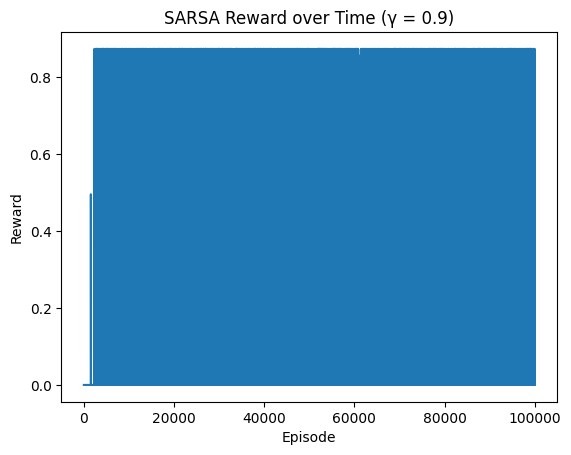


==== SARSA γ = 0.99 실험 시작 ====

γ=0.99, Episode: 100, Avg Reward (last 100): 0.0
γ=0.99, Episode: 200, Avg Reward (last 100): 0.0
γ=0.99, Episode: 300, Avg Reward (last 100): 0.0
γ=0.99, Episode: 400, Avg Reward (last 100): 0.0
γ=0.99, Episode: 500, Avg Reward (last 100): 0.0
γ=0.99, Episode: 600, Avg Reward (last 100): 0.0
γ=0.99, Episode: 700, Avg Reward (last 100): 0.0
γ=0.99, Episode: 800, Avg Reward (last 100): 0.00244
γ=0.99, Episode: 900, Avg Reward (last 100): 0.0
γ=0.99, Episode: 1000, Avg Reward (last 100): 0.0
γ=0.99, Episode: 1100, Avg Reward (last 100): 0.0
γ=0.99, Episode: 1200, Avg Reward (last 100): 0.0
γ=0.99, Episode: 1300, Avg Reward (last 100): 0.0
γ=0.99, Episode: 1400, Avg Reward (last 100): 0.0
γ=0.99, Episode: 1500, Avg Reward (last 100): 0.0
γ=0.99, Episode: 1600, Avg Reward (last 100): 0.0
γ=0.99, Episode: 1700, Avg Reward (last 100): 0.0
γ=0.99, Episode: 1800, Avg Reward (last 100): 0.004339999999999999
γ=0.99, Episode: 1900, Avg Reward (last 100): 0.1344399

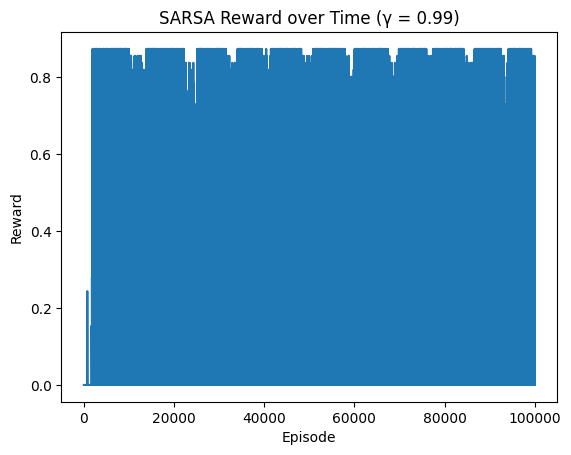

In [19]:
# sarsa 
gamma_values = [0.1, 0.5, 0.9, 0.99]
num_episodes = 100000

for gamma in gamma_values:
    print(f"\n==== SARSA γ = {gamma} 실험 시작 ====\n")
    
    env = gen_wrapped_env('MiniGrid-Empty-6x6-v0')  
    obs = env.reset()
    agent_position = obs[0]
    
    agent = SARSA(4, agent_position)
    agent.gamma = gamma  
    
    rewards = []
    for ep in range(num_episodes):
        done = False
        obs = env.reset()
        action = agent.act(obs)
        
        ep_rewards = 0
        while not done:
            next_obs, reward, done, info = env.step(action)
            next_action = agent.act(next_obs)
            
            agent.update(obs, action, reward, next_obs, next_action)
            
            ep_rewards += reward
            obs = next_obs
            action = next_action
        
        rewards.append(ep_rewards)
        if (ep+1) % 100 == 0:
            avg_reward = np.mean(rewards[-100:])
            print(f"γ={gamma}, Episode: {ep+1}, Avg Reward (last 100): {avg_reward}")
    
    env.close()
    
    # 보상 그래프 시각화
    plt.plot(rewards)
    plt.xlabel('Episode')
    plt.ylabel('Reward')
    plt.title(f'SARSA Reward over Time (γ = {gamma})')
    plt.show()

In [22]:
{s:np.round(q, 10).tolist() for s, q in agent.q_values.items()}
show_video() 